## Часть первая: перенос стиля при помощи pix2pix
В этом задании мы будем реализовывать перенос стиля на paired данных. Из стандартных датасетов я выбрал самый маленький -- давайте реализуем перенос стиля из масок сегментации в “настоящие фотографии” для конкретного случая фасадов домов.


In [ ]:
!wget http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/facades.tar.gz

!tar -xf facades.tar.gz

--2021-12-19 16:05:38--  http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/facades.tar.gz
Resolving efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)... 128.32.244.190
Connecting to efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)|128.32.244.190|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 30168306 (29M) [application/x-gzip]
Saving to: ‘facades.tar.gz’

facades.tar.gz      100%[===================>]  28.77M  4.57MB/s    in 6.8s    

2021-12-19 16:05:45 (4.24 MB/s) - ‘facades.tar.gz’ saved [30168306/30168306]



In [ ]:
from glob import glob
import itertools
import random

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable

from PIL import Image
from torchvision import transforms, utils
from IPython.display import display
from tqdm import tqdm

In [ ]:
class FacsdesDataset(torch.utils.data.Dataset):
    
    def __init__(self, folder='facades/train'):
        self.folder = folder
        self.files = glob(self.folder + '/*.jpg');
        self.transforms = transforms.Compose([
            transforms.ToTensor(),
        ])
        
    def __getitem__(self, idx):
        imgs = Image.open(self.files[idx]).convert("RGB")
        img_from, img_to = imgs.crop((256, 0, 512, 256)), imgs.crop((0, 0, 256, 256))
        return self.transforms(img_from), self.transforms(img_to)    
        
    def __len__(self):
        return len(self.files)


train_dataset = FacsdesDataset(folder='facades/train')
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=8, shuffle=True)

val_dataset = FacsdesDataset(folder='facades/test')
val_dataloader = torch.utils.data.DataLoader(val_dataset, batch_size=8, shuffle=False)

In [ ]:
def conv_layer(in_challels, out_channels):
    return nn.Sequential(
        nn.Conv2d(in_challels, out_channels, kernel_size=3, padding=1),
        nn.InstanceNorm2d(out_channels, affine=True),
        nn.LeakyReLU(0.2, inplace=True),
        nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
        nn.InstanceNorm2d(out_channels, affine=True),
        nn.LeakyReLU(0.2, inplace=True),
    )

class UnetGenerator(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv_down1 = conv_layer(3, 64)
        self.conv_down2 = conv_layer(64, 128)
        self.conv_down3 = conv_layer(128, 256)
        self.conv_down4 = conv_layer(256, 512)
        self.conv_down5 = conv_layer(512, 1024)
        
        self.conv_up1 = conv_layer(512 + 1024, 512)
        self.conv_up2 = conv_layer(256 + 512, 256)
        self.conv_up3 = conv_layer(128 + 256, 128)
        self.conv_up4 = conv_layer(64 + 128, 64)
        self.conv_up5 = nn.Conv2d(64, 3, kernel_size=1)
        
        self.down = nn.MaxPool2d(kernel_size=2)
        self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        
        
    def forward(self, x):
        out1 = self.conv_down1(x)
        out1 = F.dropout(out1)
        x = self.down(out1)
        
        out2 = self.conv_down2(x)
        out2 = F.dropout(out2)
        x = self.down(out2)
        
        out3 = self.conv_down3(x)
        out3 = F.dropout(out3)
        x = self.down(out3)

        out4 = self.conv_down4(x)
        out4 = F.dropout(out4)
        x = self.down(out4)
        
        x = self.conv_down5(x)
        
        x = self.up(x)    
        x = torch.cat([x, out4], dim=1)
        x = self.conv_up1(x)
        
        x = self.up(x)        
        x = torch.cat([x, out3], dim=1)
        x = self.conv_up2(x)
        
        x = self.up(x)        
        x = torch.cat([x, out2], dim=1)
        x = self.conv_up3(x)

        x = self.up(x)        
        x = torch.cat([x, out1], dim=1)
        x = self.conv_up4(x)
        
        x = self.conv_up5(x)
        x = torch.sigmoid(x)
        return x
   
        

class Discriminator(nn.Module):
    def __init__(self, is_single=False):
        super().__init__()
        self.is_single = is_single
        self.conv_down1 = conv_layer(3 if is_single else 6, 64)
        self.conv_down2 = conv_layer(64, 128)
        self.conv_down3 = conv_layer(128, 256)
        self.conv_down4 = conv_layer(256, 512)
        self.down = nn.MaxPool2d(kernel_size=2)
        
        self.pooling = nn.AdaptiveAvgPool2d((1, 1))
        self.fc = nn.Linear(512, 2)
        
    def forward(self, condition, x=None):
        if self.is_single:
            x = condition
        else:
            x = torch.cat([condition, x], dim=1)
        
        x = self.conv_down1(x)
        x = self.down(x)
        x = F.dropout(x)
        
        x = self.conv_down2(x)
        x = self.down(x)
        x = F.dropout(x)
        
        x = self.conv_down3(x)
        x = self.down(x)
        
        x = self.conv_down4(x)
        x = self.down(x) 
        
        x = self.pooling(x)
        x = x.squeeze(-1).squeeze(-1) 
        x = self.fc(x)

        return x
        
        

In [ ]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
device

device(type='cuda')

In [ ]:
G = UnetGenerator().to(device)
D = Discriminator().to(device)

In [ ]:
G_optim = torch.optim.Adam(G.parameters(), lr=0.0002, betas=(0.5, 0.999))
G_scheduler = torch.optim.lr_scheduler.StepLR(G_optim, 200)
D_optim = torch.optim.Adam(D.parameters(), lr=0.0002, betas=(0.5, 0.999))
D_scheduler = torch.optim.lr_scheduler.StepLR(D_optim, 200)

Epoch: 20


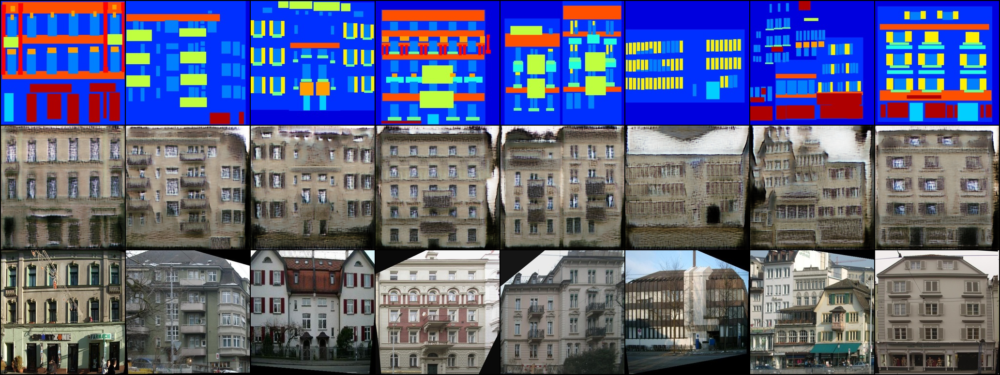

Epoch: 40


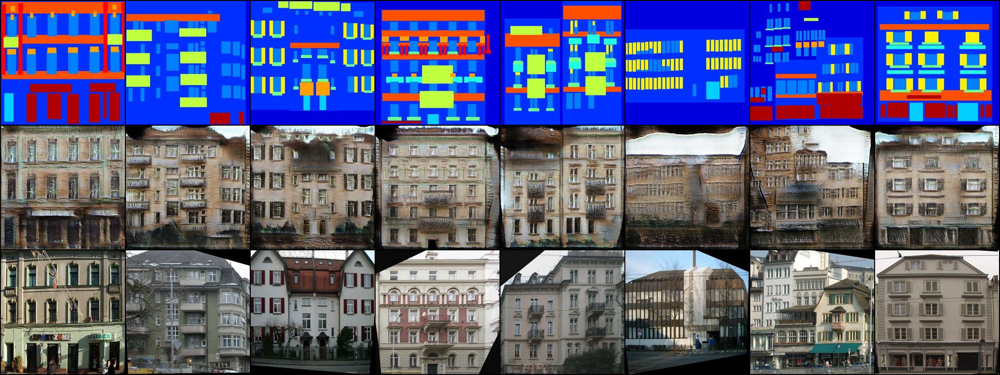

Epoch: 60


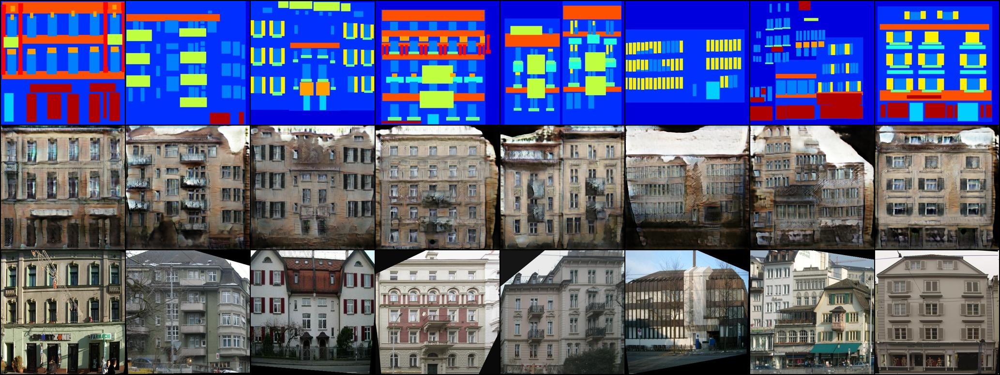

Epoch: 80


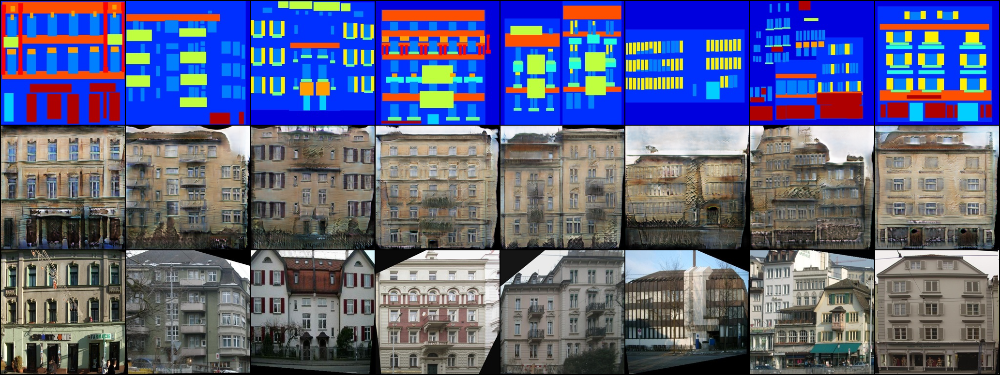

Epoch: 100


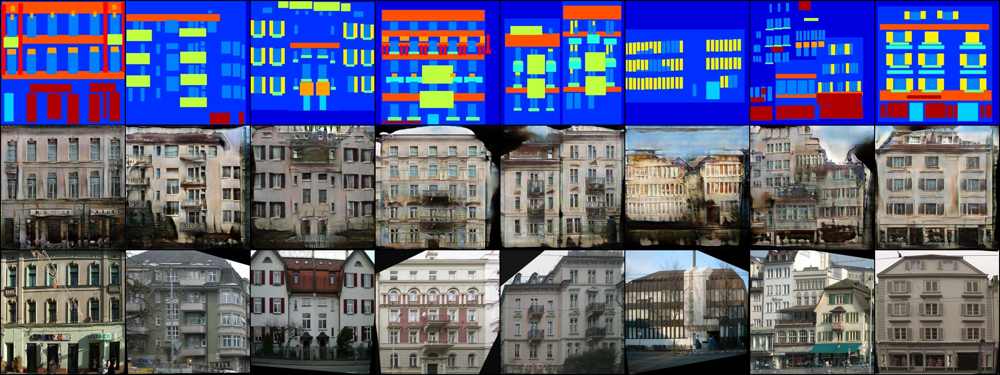

Epoch: 120


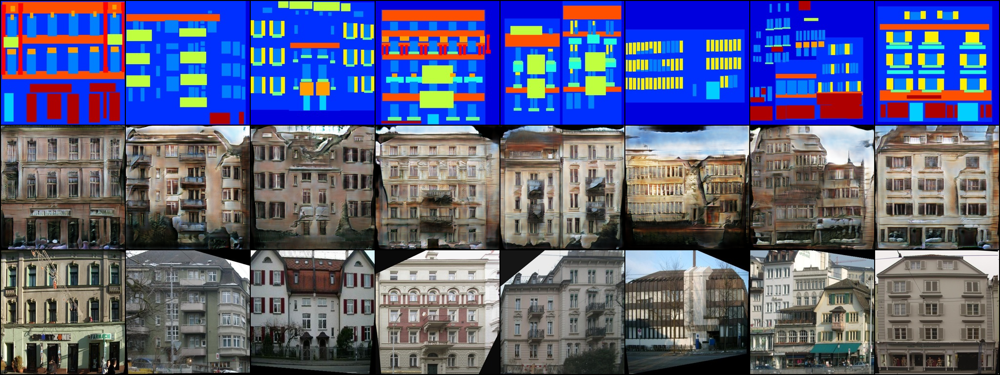

Epoch: 140


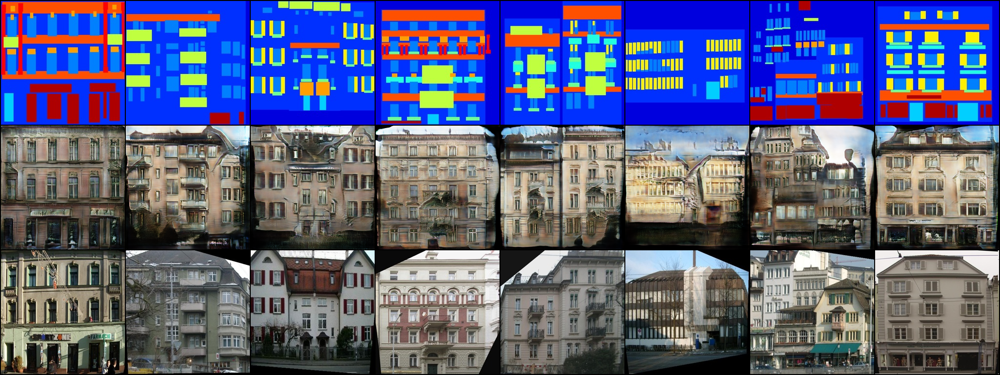

Epoch: 160


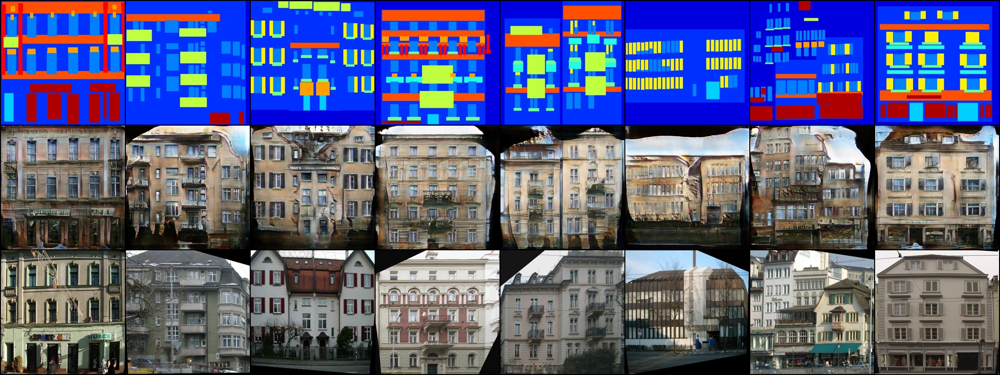

Epoch: 180


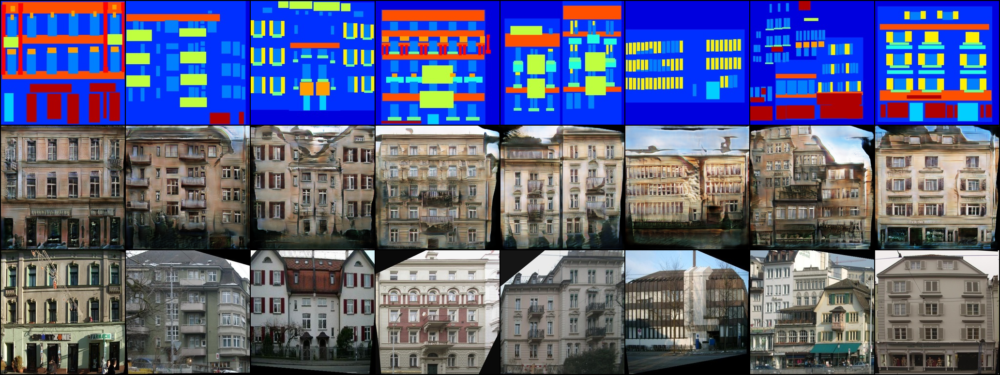

Epoch: 200


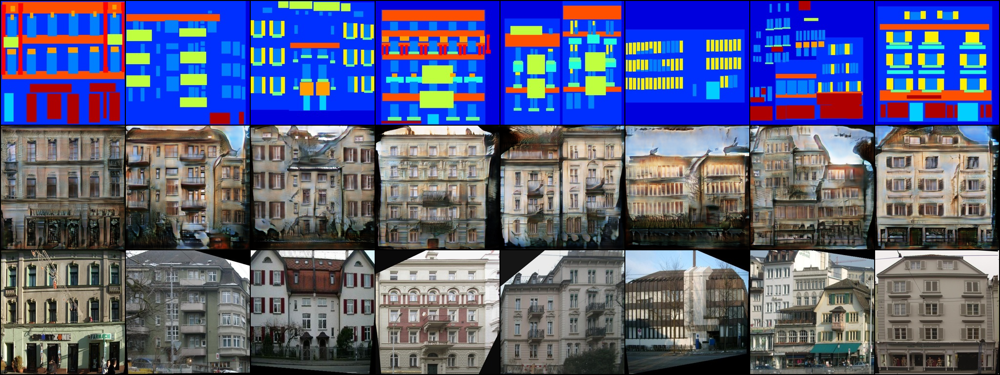

In [ ]:
D_hist = []
G_hist = []
for epoch in range(1, 201):
    
    pbar = tqdm(enumerate(train_dataloader), total=len(train_dataloader), leave=False, position=0)
    for i, batch in pbar:

        condition, img_real = batch
        condition = condition.to(device)
        img_real = img_real.to(device)

        G.eval()
        D.train()
        D_optim.zero_grad()

        img_fake = G(condition)
        logits_fake = D(condition, img_fake)
        logits_real = D(condition, img_real)
        D_fake_loss = F.cross_entropy(logits_fake, torch.zeros(logits_fake.shape[0]).long().to(device))
        D_real_loss = F.cross_entropy(logits_real, torch.ones(logits_fake.shape[0]).long().to(device))
        D_loss = (D_fake_loss + D_real_loss) * 0.5
        
        D_loss.backward()
        D_optim.step()
        D_hist.append(D_loss.item())
        
        G.train()
        D.eval()
        G_optim.zero_grad()

        img_fake = G(condition)
        logits_fake = D(condition, img_fake)
        G_cross_entropy = F.cross_entropy(logits_fake, torch.ones(logits_fake.shape[0]).long().to(device))
        G_l1 = F.l1_loss(img_fake, img_real)
        G_loss = G_cross_entropy + 100 * G_l1
        
        G_loss.backward()
        G_optim.step()
        
        G_hist.append(G_loss.item())

        pbar.set_postfix({
            'D_loss': D_hist[-1],
            'G_loss': G_hist[-1],
            'G_cross_entropy': G_cross_entropy.item(),
            'G_l1': G_l1.item()
        })
    G_scheduler.step()
    D_scheduler.step()

    if epoch % 20 == 0:
        G.train() 
        print(f'Epoch: {epoch}')
        for val_condition, val_img_real in val_dataloader:
            val_condition = val_condition.to(device)
            val_img_fake = G(val_condition).cpu().detach()
            img_to_show = torch.cat([val_condition.cpu(), val_img_fake, val_img_real], dim=0)
            display(transforms.ToPILImage()(utils.make_grid(img_to_show)))
            break
    


## Часть вторая: добавим циклы

Вторая часть -- реализация CycleGAN. Предлагается на том же датасете реализовать базовую конструкцию CycleGAN для unpaired style transfer, то есть переноса стилей, каждый из которых задан неразмеченным датасетом


In [ ]:
train_dataset = FacsdesDataset(folder='facades/train')
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=4, shuffle=True)

val_dataset = FacsdesDataset(folder='facades/test')
val_dataloader = torch.utils.data.DataLoader(val_dataset, batch_size=8, shuffle=False)

In [ ]:
Gx = UnetGenerator().to(device)
Gy = UnetGenerator().to(device)
Dx = Discriminator(is_single=True).to(device)
Dy = Discriminator(is_single=True).to(device)

In [ ]:
G_optim = torch.optim.Adam(itertools.chain(Gx.parameters(), Gy.parameters()), lr=0.0002, betas=(0.5, 0.999))
D_optim = torch.optim.Adam(itertools.chain(Dx.parameters(), Dy.parameters()), lr=0.0002, betas=(0.5, 0.999))

Epoch: 10


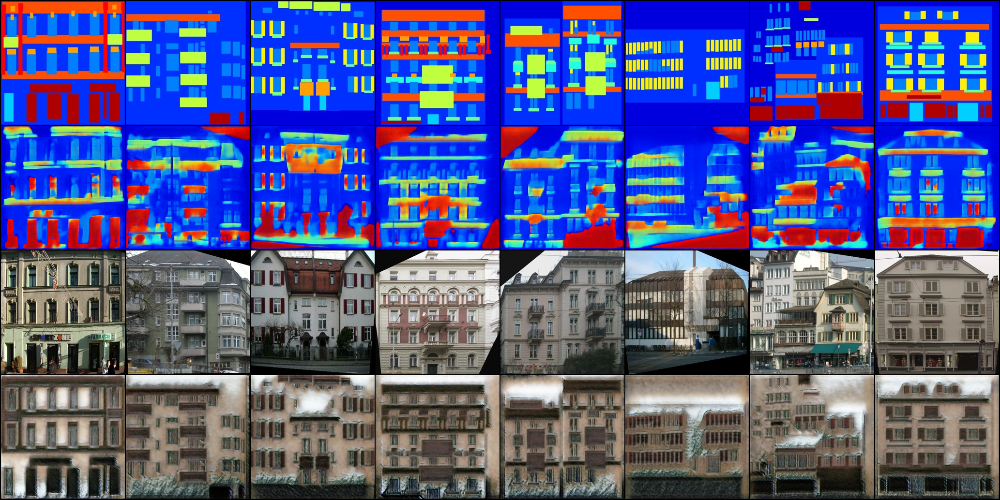

Epoch: 20


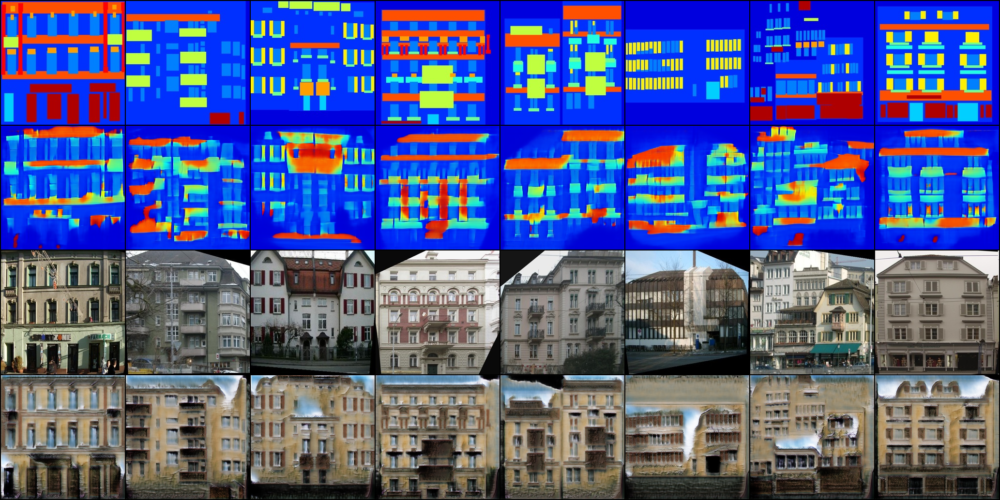

Epoch: 30


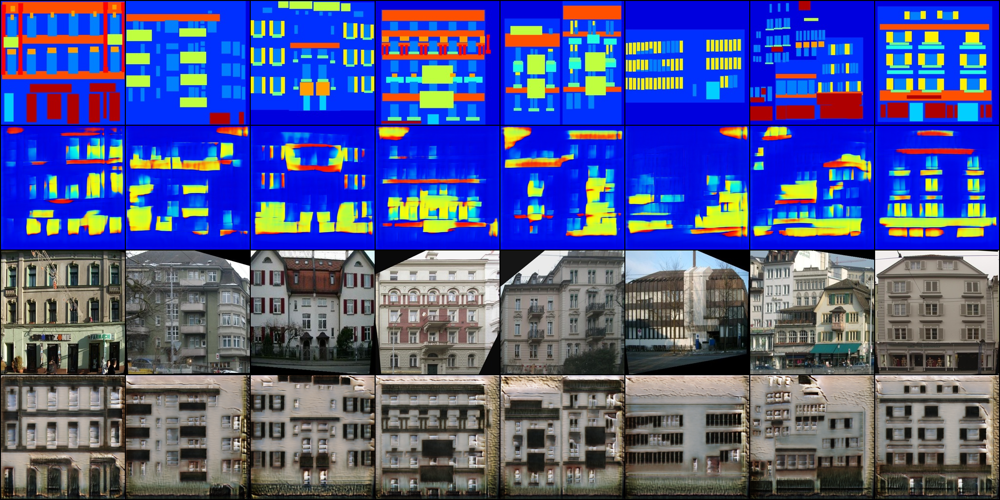

Epoch: 40


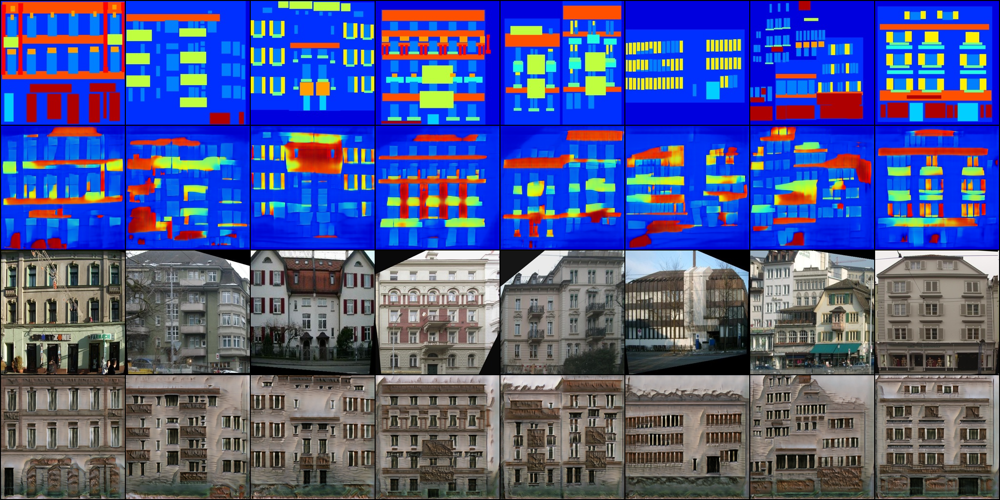

Epoch: 50


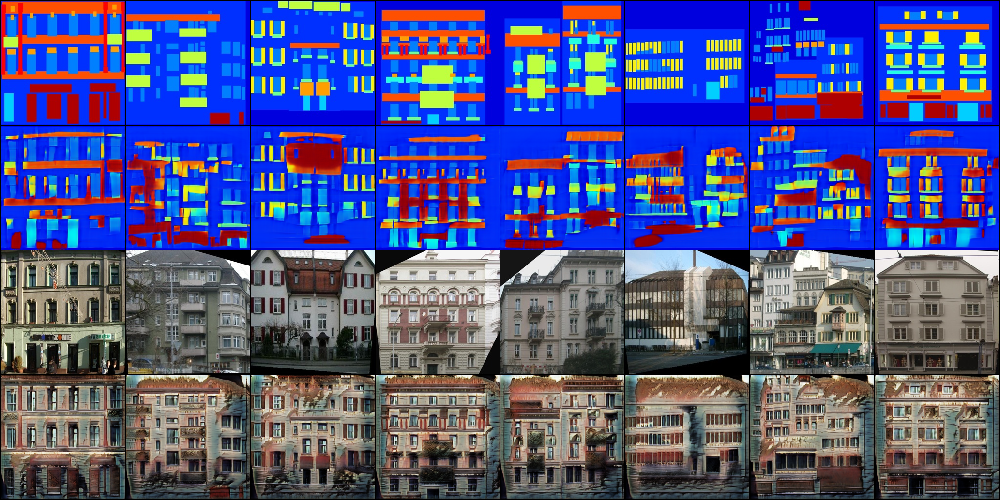

In [ ]:
for epoch in range(1, 51):
    
    pbar = tqdm(enumerate(train_dataloader), total=len(train_dataloader), leave=False, position=0)
    for i, batch in pbar:

        X, Y = batch
        X = X.to(device)
        Y = Y.to(device)

        Gx.eval()
        Gy.eval()
        Dx.train()
        Dy.train()
        D_optim.zero_grad()
 
        Y_fake = Gx(X)
        X_fake = Gy(Y)

        X_logits_fake = Dx(X_fake)
        X_logits_real = Dx(X)

        Y_logits_fake = Dy(Y_fake)
        Y_logits_real = Dy(Y)

        Dx_fake_loss = F.cross_entropy(X_logits_fake, torch.zeros(X_logits_fake.shape[0]).long().to(device))
        Dx_real_loss = F.cross_entropy(X_logits_real, torch.ones(X_logits_fake.shape[0]).long().to(device))
        Dx_loss = (Dx_fake_loss + Dx_real_loss) * 0.5

        Dy_fake_loss = F.cross_entropy(Y_logits_fake, torch.zeros(Y_logits_fake.shape[0]).long().to(device))
        Dy_real_loss = F.cross_entropy(Y_logits_real, torch.ones(Y_logits_fake.shape[0]).long().to(device))
        Dy_loss = (Dy_fake_loss + Dy_real_loss) * 0.5

        D_loss = Dx_loss + Dy_loss
        
        D_loss.backward()
        D_optim.step()
        
        
        Gx.train()
        Gy.train()
        Dx.eval()
        Dy.eval()
        G_optim.zero_grad()
        

        Y_fake = Gx(X)
        X_fake = Gy(Y)
        Y_rec = Gx(X_fake)
        X_rec = Gy(Y_fake)

        G_identity_rec = 10 * F.l1_loss(X, X_rec) + 10 * F.l1_loss(Y, Y_rec)
        G_identity = 0.5 * (10 * F.l1_loss(X, X_fake) + 10 * F.l1_loss(Y, Y_fake)) # можем себе позволить, т.к. данные спаренны

        X_logits_fake = Dx(X_fake)
        Y_logits_fake = Dy(Y_fake)

        Gx_cross_entropy = F.cross_entropy(X_logits_fake, torch.ones(X_logits_fake.shape[0]).long().to(device))
        Gy_cross_entropy = F.cross_entropy(Y_logits_fake, torch.ones(Y_logits_fake.shape[0]).long().to(device))
        
        G_loss = Gx_cross_entropy + Gy_cross_entropy + G_identity_rec + G_identity

        G_loss.backward()
        G_optim.step()
        

        pbar.set_postfix({
            'D_loss': D_loss.item(),
            'G_loss': G_loss.item(),
            'Gx_cross_entropy': Gx_cross_entropy.item(),
            'Gy_cross_entropy': Gy_cross_entropy.item(),
            'G_identity_rec': G_identity_rec.item(),
            'G_identity': G_identity.item(),
        })

    if epoch % 10 == 0:
        Gx.eval() 
        Gy.eval()
        print(f'Epoch: {epoch}')
        for X, Y in val_dataloader:
            X = X.to(device)
            Y = Y.to(device)
            with torch.no_grad():
                Y_fake = Gx(X).cpu().detach()
                X_fake = Gy(Y).cpu().detach()
            img_to_show = torch.cat([X.cpu(), X_fake, Y.cpu(), Y_fake], dim=0)
            display(transforms.ToPILImage()(utils.make_grid(img_to_show)))
            break